In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, Lasso, RidgeCV, LassoCV, ElasticNet, ElasticNetCV, LogisticRegression, LogisticRegressionCV
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import seaborn as sns
import pickle

In [2]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

In [3]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [4]:
pf = ProfileReport(df)

In [5]:
pf

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
pf.to_notebook_iframe()

In [8]:
#we don't have any NaN values, but we have so many ZEROES values may be because of device failure
#we may update these zeroes with suitable operations like mean , median , mode etc.

In [9]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [10]:
df["BMI"] = df["BMI"].replace(0, df["BMI"].mean())

In [11]:
df["BloodPressure"] = df["BloodPressure"].replace(0, df["BloodPressure"].mean())

In [12]:
df["Insulin"] = df["Insulin"].replace(0, df["Insulin"].mean())

In [13]:
df["Glucose"] = df["Glucose"].replace(0, df["Glucose"].mean())

In [14]:
df["SkinThickness"] = df["SkinThickness"].replace(0, df["SkinThickness"].mean())

In [15]:
# in many of the observations, we saw that many of the datasets were skewed, 
# therefore its better to replace zeroes with mean and not median or mode

In [16]:
# let us check out if there is still some skewness or not
pf = ProfileReport(df)

In [17]:
pf

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [18]:
# we can observe that zeroes are removed
# now let us find whether we have any outliers or not
#outliers presence may give skewed graph

In [19]:
#boxplot can help us to find outliers
fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df, ax = axis)

<AxesSubplot:>

In [20]:
%matplotlib inline

In [21]:
sns.boxplot(data = df, ax = axis)

<AxesSubplot:>

<AxesSubplot:>

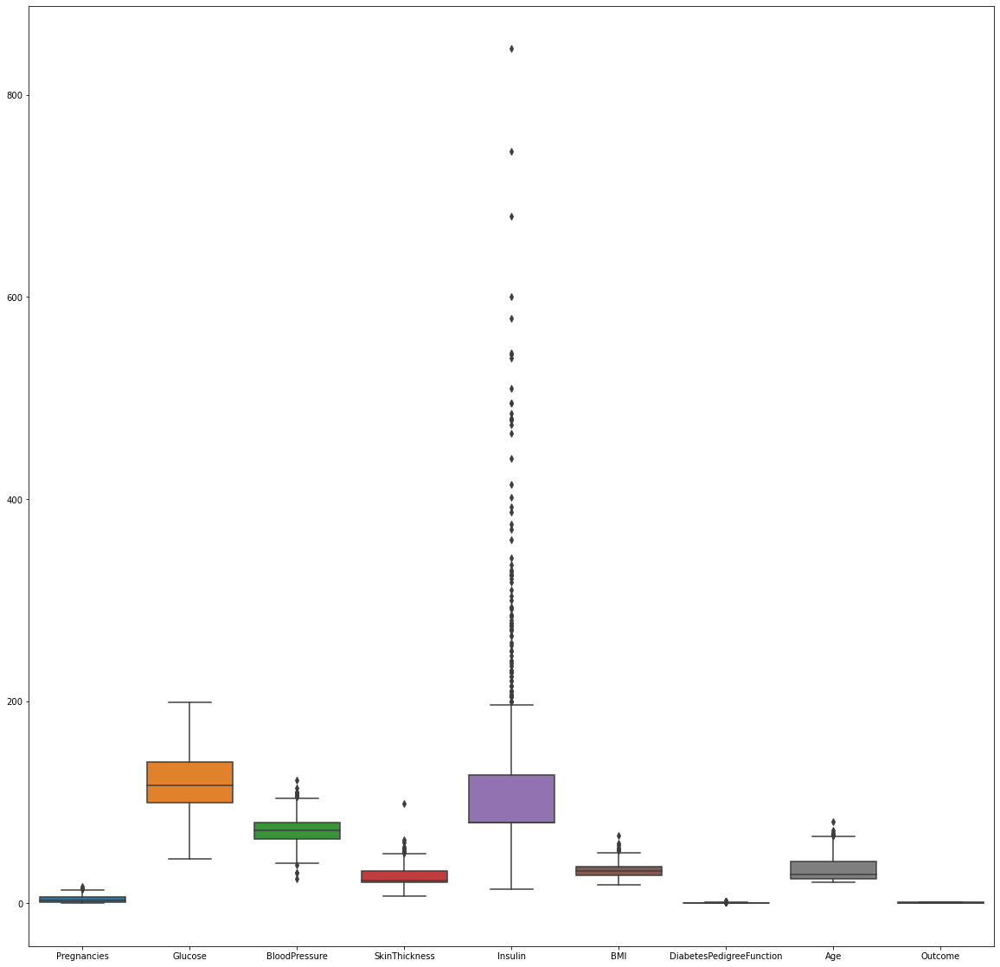

In [22]:
fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df, ax = axis)

In [23]:
# we can see that Glucose has no outliers and Insulin has so many outliers
# so let us handle these outliers

In [24]:
q =df["Insulin"].quantile(0.95) #removing 5%
df_new = df[df["Insulin"] < q]

<AxesSubplot:>

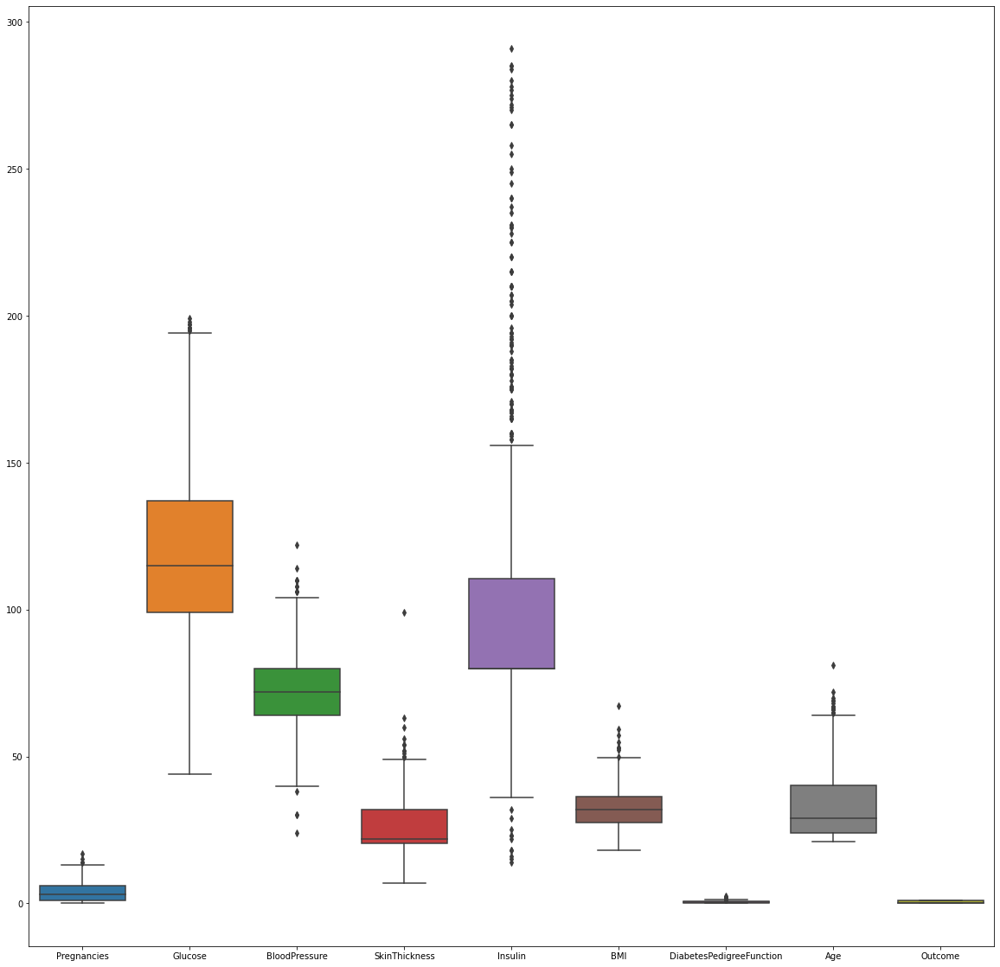

In [26]:
fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = axis)

In [27]:
q =df["Insulin"].quantile(0.90) #removing 10% dataset
df_new = df[df["Insulin"] < q]

<AxesSubplot:>

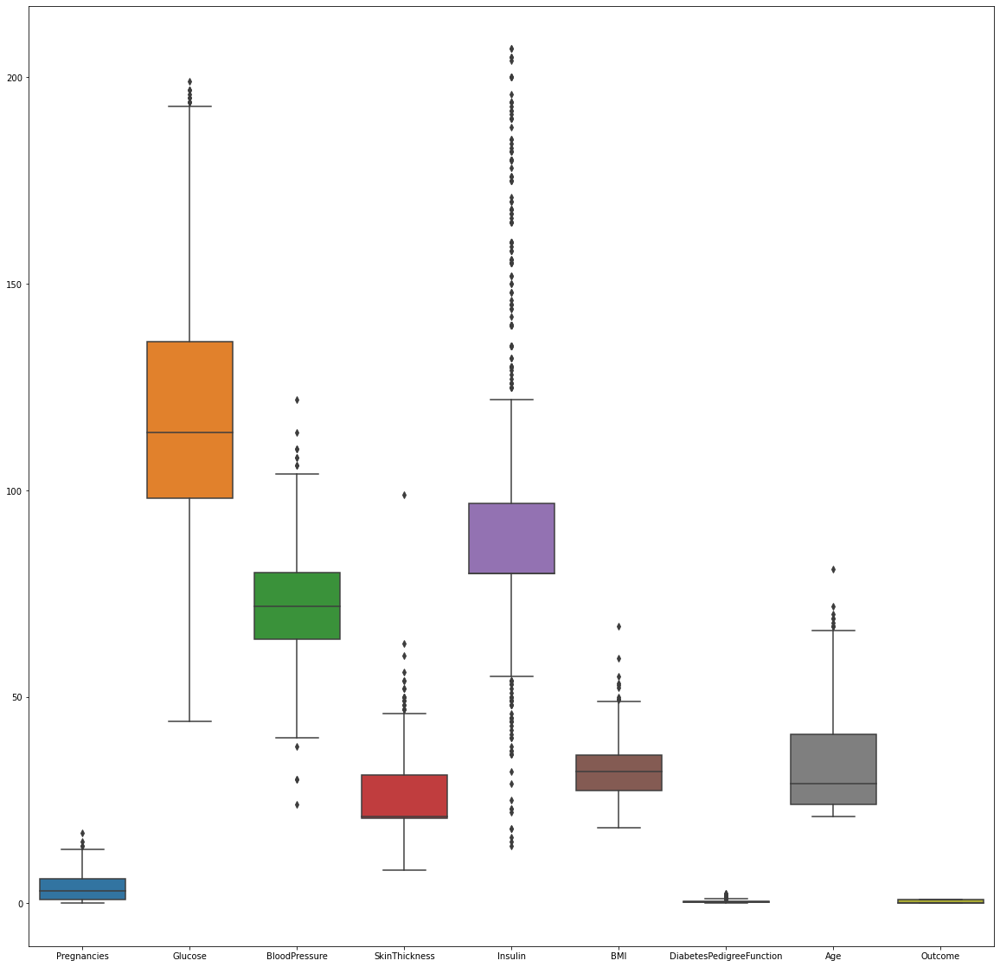

In [28]:
fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = axis)

In [29]:
q =df["Insulin"].quantile(0.70) #removing 30% dataset
df_new = df[df["Insulin"] < q]

<AxesSubplot:>

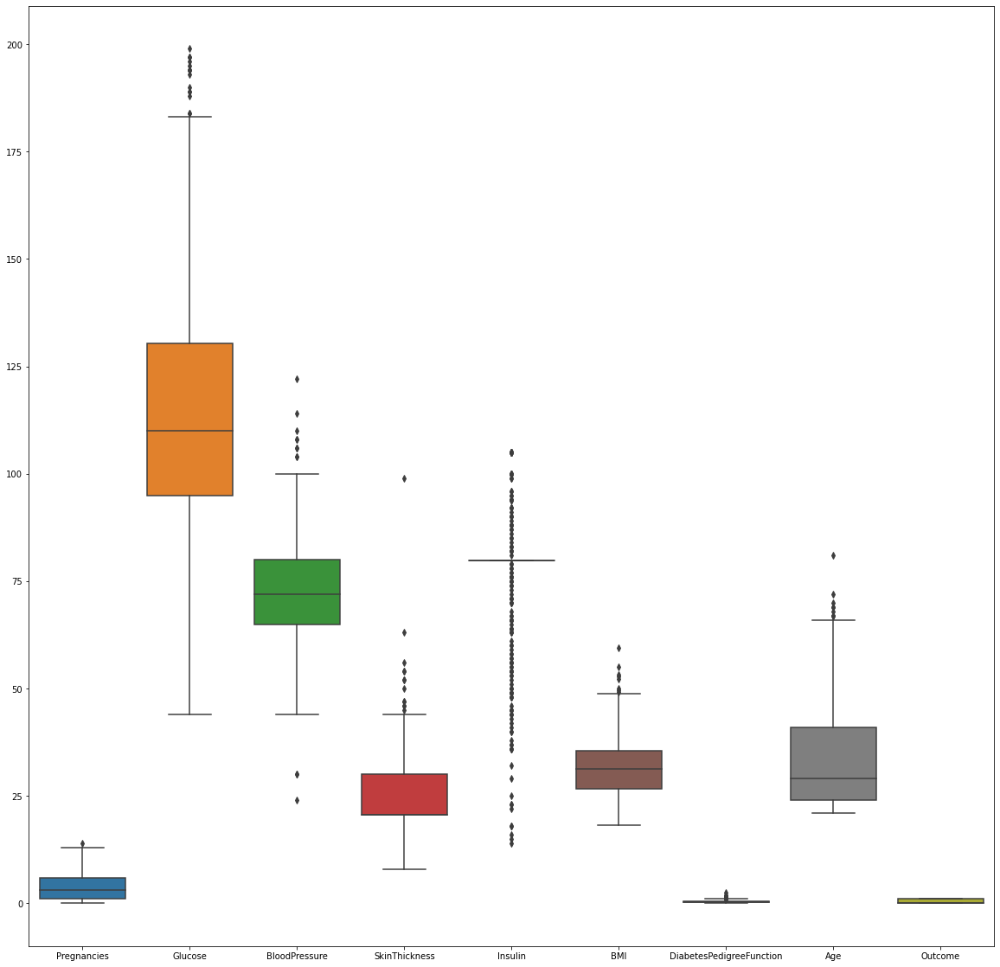

In [30]:
fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = axis)

<AxesSubplot:>

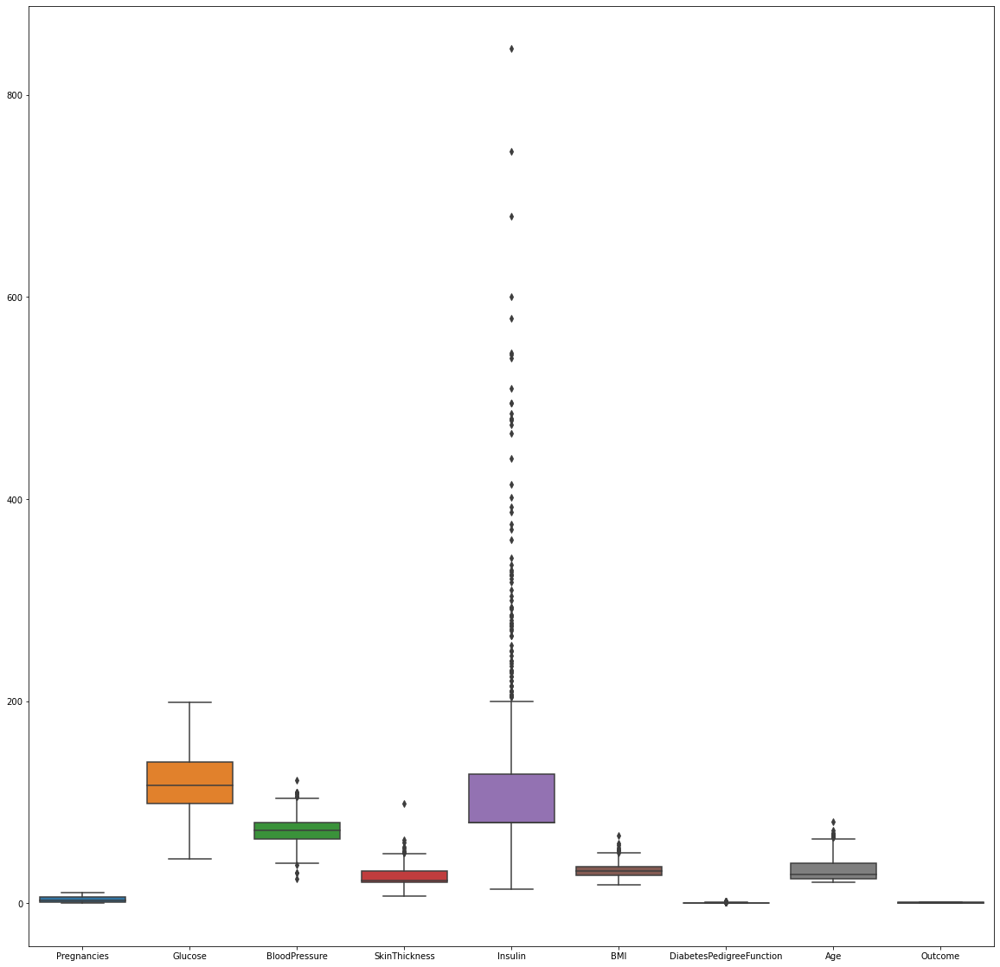

In [36]:
q =df["Pregnancies"].quantile(0.98)
df_new = df[df["Pregnancies"] < q]
fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = axis)

<AxesSubplot:>

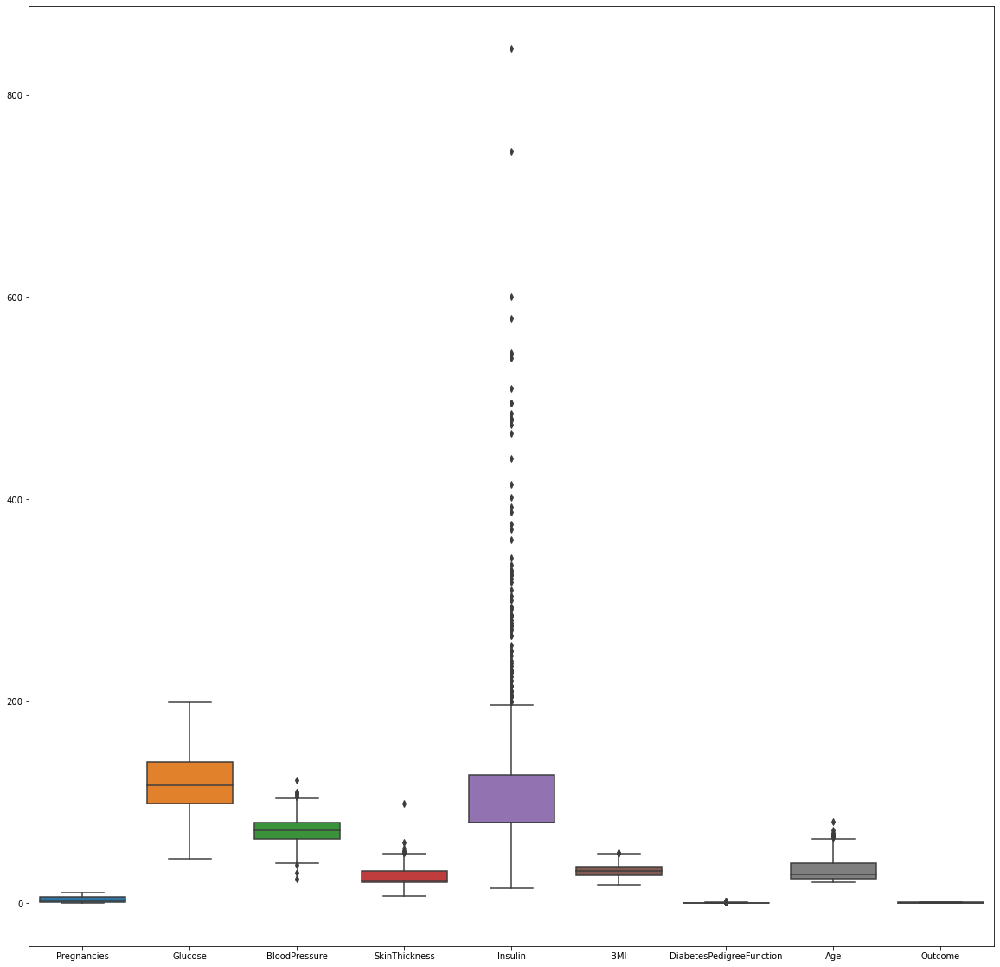

In [37]:
q =df_new["BMI"].quantile(0.99)
df_new = df_new[df_new["BMI"] < q]
fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = axis)

<AxesSubplot:>

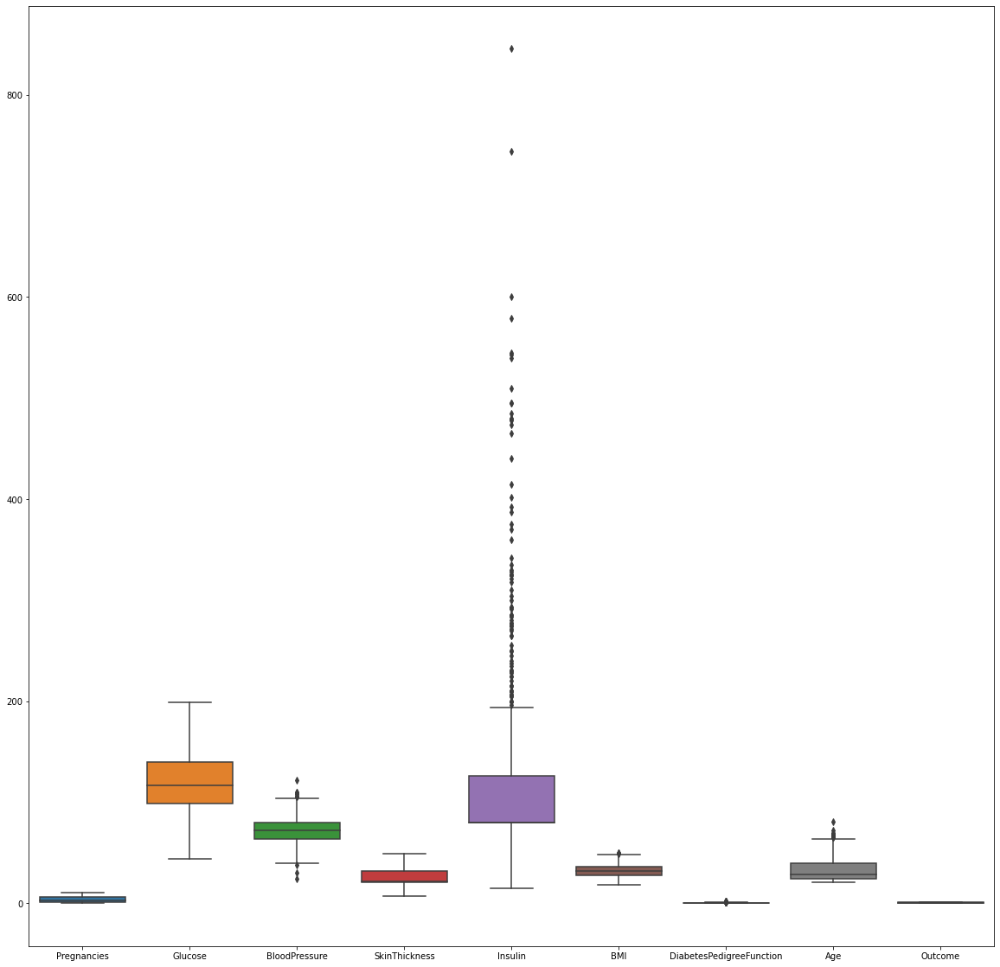

In [38]:
q = df["Pregnancies"].quantile(0.98)
df_new = df[df["Pregnancies"]<q]

q =df_new["BMI"].quantile(0.99)
df_new = df_new[df_new["BMI"] < q]

q =df_new["SkinThickness"].quantile(0.99)
df_new = df_new[df_new["SkinThickness"] < q]

fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = axis)

<AxesSubplot:>

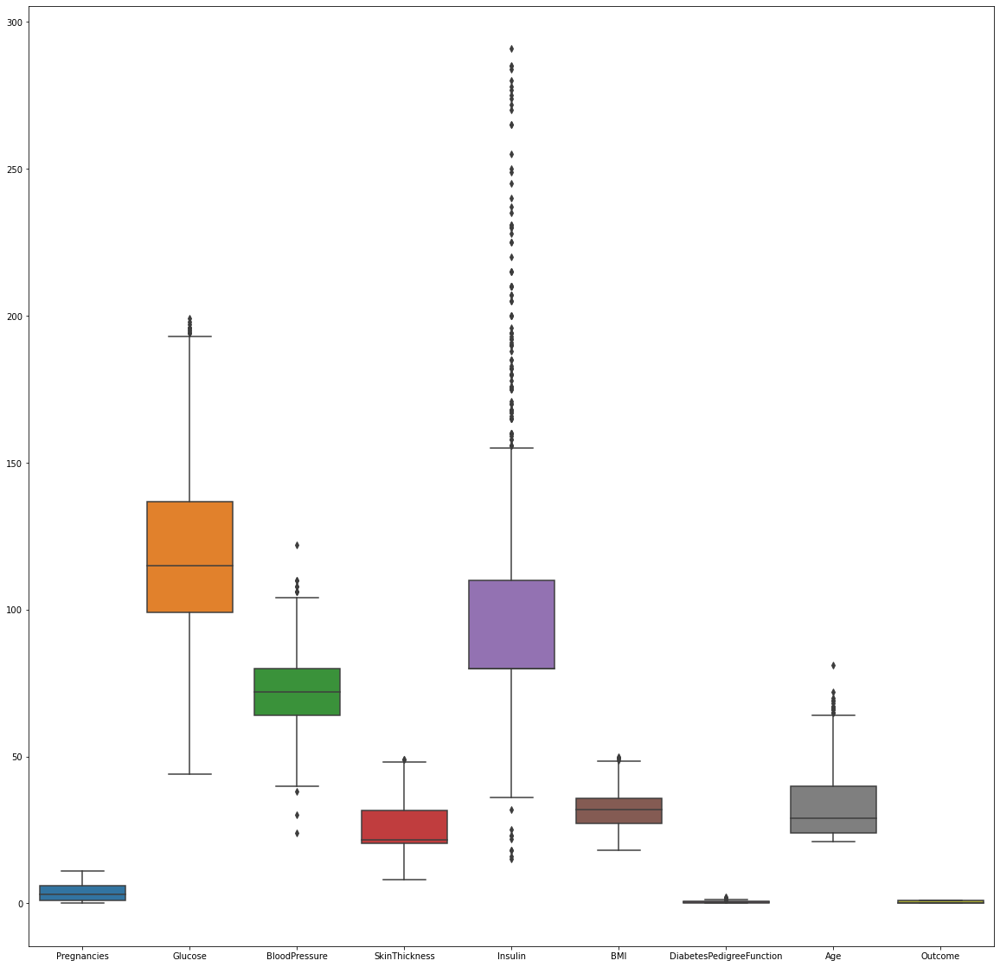

In [39]:
q = df["Pregnancies"].quantile(0.98)
df_new = df[df["Pregnancies"]<q]

q =df_new["BMI"].quantile(0.99)
df_new = df_new[df_new["BMI"] < q]

q =df_new["SkinThickness"].quantile(0.99)
df_new = df_new[df_new["SkinThickness"] < q]

q =df_new["Insulin"].quantile(0.95)
df_new = df_new[df_new["Insulin"] < q]

fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = axis)

<AxesSubplot:>

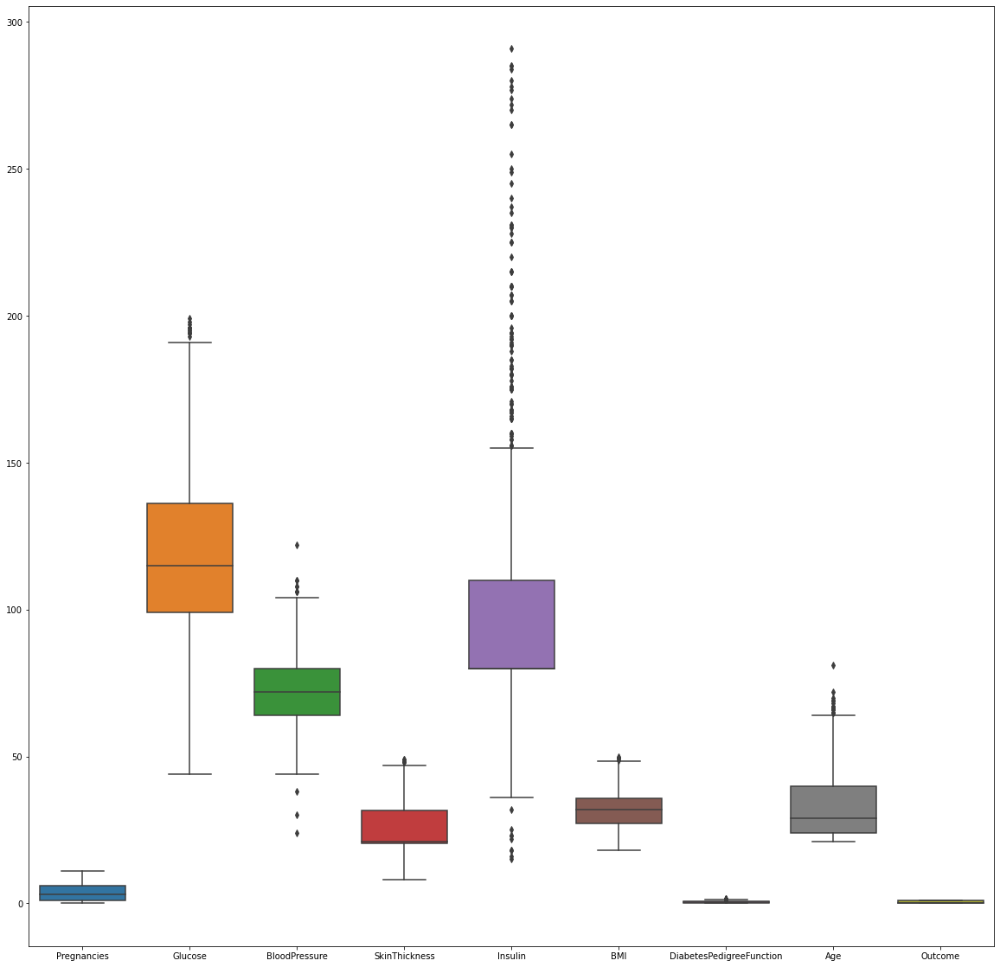

In [40]:
q = df["Pregnancies"].quantile(0.98)
df_new = df[df["Pregnancies"]<q]

q =df_new["BMI"].quantile(0.99)
df_new = df_new[df_new["BMI"] < q]

q =df_new["SkinThickness"].quantile(0.99)
df_new = df_new[df_new["SkinThickness"] < q]

q =df_new["Insulin"].quantile(0.95)
df_new = df_new[df_new["Insulin"] < q]

q =df_new["DiabetesPedigreeFunction"].quantile(0.99)
df_new = df_new[df_new["DiabetesPedigreeFunction"] < q]

fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = axis)

<AxesSubplot:>

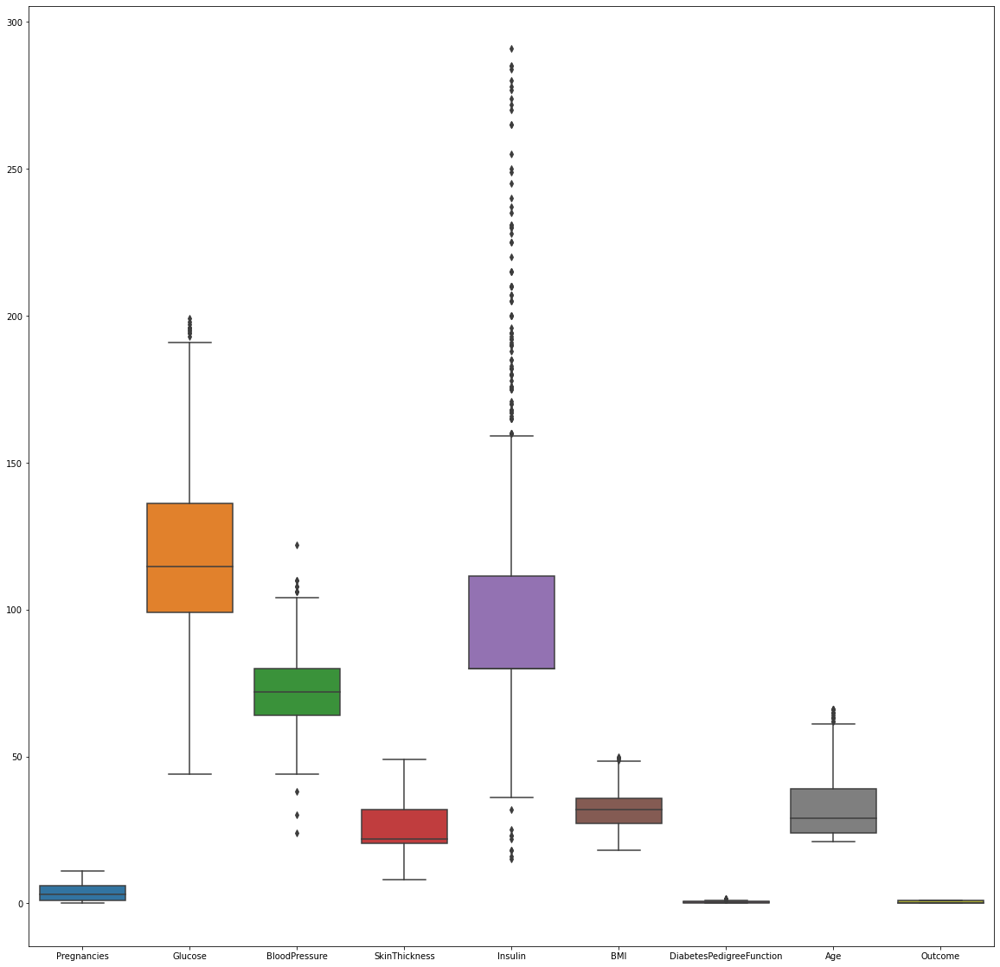

In [41]:
q = df["Pregnancies"].quantile(0.98)
df_new = df[df["Pregnancies"]<q]

q =df_new["BMI"].quantile(0.99)
df_new = df_new[df_new["BMI"] < q]

q =df_new["SkinThickness"].quantile(0.99)
df_new = df_new[df_new["SkinThickness"] < q]

q =df_new["Insulin"].quantile(0.95)
df_new = df_new[df_new["Insulin"] < q]

q =df_new["DiabetesPedigreeFunction"].quantile(0.99)
df_new = df_new[df_new["DiabetesPedigreeFunction"] < q]

q =df_new["Age"].quantile(0.99)
df_new = df_new[df_new["Age"] < q]

fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = axis)

In [42]:
pf = ProfileReport(df_new)

In [43]:
pf

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [44]:
# program to remove outliers from one of the student

"""
def outlier_removal(data):
    
    def outlier_limits(col):
        Q3, Q1 = np.nanpercentile(col, [75,25])
        IQR = Q3 - Q1
        UL = Q3 + (1.5*IQR)
        LL = Q1 - (1.5*IQR)
        return UL, LL
    
    for column in data.columns:
        if data[column].dtype != "int64":
            UL, LL = outlier_limits(data[column])
            data[column] = np.where((data[column]>UL) | (data[column]<LL), np.nan, data[column])
            
"""

'\ndef outlier_removal(data):\n    \n    def outlier_limits(col):\n        Q3, Q1 = np.nanpercentile(col, [75,25])\n        IQR = Q3 - Q1\n        UL = Q3 + (1.5*IQR)\n        LL = Q1 - (1.5*IQR)\n        return UL, LL\n    \n    for column in data.columns:\n        if data[column].dtype != "int64":\n            UL, LL = outlier_limits(data[column])\n            data[column] = np.where((data[column]>UL) | (data[column]<LL), np.nan, data[column])\n            \n'

In [45]:
#hit and trial with quantile ranges is one of the way to remove outliers
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [46]:
y = df_new["Outcome"]
x = df_new.drop(columns=["Outcome"])

In [47]:
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [48]:
x

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30
...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [49]:
 # since our dataset is fluctuating a lot...so we need to standardizze
scalar = StandardScaler()
scalar.fit_transform(df_new)

array([[ 7.96753910e-01,  9.83984062e-01,  4.52611463e-04, ...,
         6.30484542e-01,  1.60141519e+00,  1.43170310e+00],
       [-8.64793539e-01, -1.16977621e+00, -5.04474494e-01, ...,
        -3.38078670e-01, -1.32706484e-01, -6.98468839e-01],
       [ 1.46137289e+00,  2.18051755e+00, -6.72783529e-01, ...,
         7.88402456e-01, -4.14369227e-02,  1.43170310e+00],
       ...,
       [ 4.64444420e-01,  6.09439465e-02,  4.52611463e-04, ...,
        -7.10063091e-01, -2.23976046e-01, -6.98468839e-01],
       [-8.64793539e-01,  2.31877301e-01, -1.00940160e+00, ...,
        -3.45097244e-01,  1.32760650e+00,  1.43170310e+00],
       [-8.64793539e-01, -8.96282840e-01, -1.67856424e-01, ...,
        -4.64413001e-01, -8.62862978e-01, -6.98468839e-01]])

In [50]:
ProfileReport(pd.DataFrame(scalar.fit_transform(df_new)))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:>

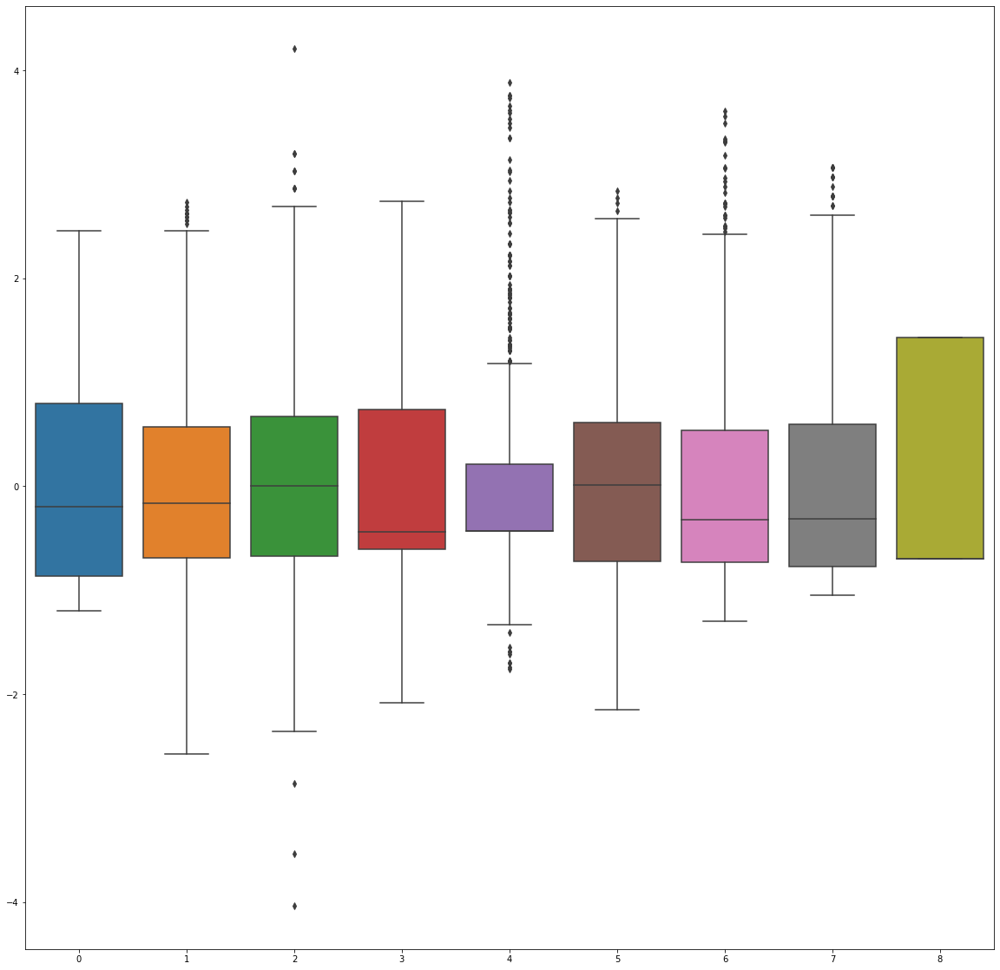

In [51]:
df_new_scalar = pd.DataFrame(scalar.fit_transform(df_new))
fig, axis = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new_scalar, ax = axis)

In [52]:
scalar = StandardScaler()
x_scaled = scalar.fit_transform(x)

In [53]:
x_scaled

array([[ 7.96753910e-01,  9.83984062e-01,  4.52611463e-04, ...,
         2.65819648e-01,  6.30484542e-01,  1.60141519e+00],
       [-8.64793539e-01, -1.16977621e+00, -5.04474494e-01, ...,
        -8.31445036e-01, -3.38078670e-01, -1.32706484e-01],
       [ 1.46137289e+00,  2.18051755e+00, -6.72783529e-01, ...,
        -1.34872696e+00,  7.88402456e-01, -4.14369227e-02],
       ...,
       [ 4.64444420e-01,  6.09439465e-02,  4.52611463e-04, ...,
        -8.94145875e-01, -7.10063091e-01, -2.23976046e-01],
       [-8.64793539e-01,  2.31877301e-01, -1.00940160e+00, ...,
        -2.82812694e-01, -3.45097244e-01,  1.32760650e+00],
       [-8.64793539e-01, -8.96282840e-01, -1.67856424e-01, ...,
        -2.35787064e-01, -4.64413001e-01, -8.62862978e-01]])

In [54]:
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [55]:
def vif_score(x):
    scaler = StandardScaler()
    arr = scaler.fit_transform(x)
    return pd.DataFrame([[x.columns[i], variance_inflation_factor(arr, i)] for i in range(arr.shape[1])], columns = ["Features", "VIF_Score"])

vif_score(x)

,Features,VIF_Score
0,Pregnancies,1.449056
1,Glucose,1.304263
2,BloodPressure,1.262686
3,SkinThickness,1.470049
4,Insulin,1.271017
5,BMI,1.513160
6,DiabetesPedigreeFunction,1.042300
7,Age,1.662728


In [56]:
# we can observe that VIF_Score for each of the column is not more than 10...so its okay
train_test_split(x_scaled, y, test_size = 0.20, random_state = 144)

NameError: name 'train_test_split' is not defined

In [57]:
from sklearn.model_selection import train_test_split
train_test_split(x_scaled, y, test_size = 0.20, random_state = 144)

[array([[-0.86479354,  0.19769063, -1.85094678, ...,  0.21879402,
          1.80609569, -0.40651517],
        [ 2.45830136,  1.22329076,  0.33707068, ...,  0.21879402,
          3.1782269 ,  1.69268475],
        [ 0.13213493,  0.91561072,  1.09446134, ..., -0.47091521,
         -0.90658316, -0.49778473],
        ...,
        [-0.86479354, -0.28092276,  1.17861586, ..., -0.28281269,
         -1.06801036, -0.86286298],
        [ 1.46137289,  0.02675728,  0.50537972, ..., -1.08224839,
         -0.13454002,  2.87918905],
        [-0.86479354, -0.75953616, -0.33616546, ..., -0.73739378,
          2.27283086, -0.95413254]]),
 array([[ 1.32134931e-01, -1.44176079e-01,  4.52611463e-04, ...,
         -4.70915211e-01, -2.50346495e-01,  1.23633694e+00],
        [-1.19710303e+00,  6.76304024e-01, -8.41092564e-01, ...,
         -1.53682948e+00, -8.43415997e-01, -1.04540210e+00],
        [ 2.45830136e+00,  8.13050708e-01,  1.85185200e+00, ...,
          7.36075942e-01, -6.78479508e-01,  1.69268475e+

In [58]:
x_train, x_test, y_train, y_test = train_test_split(x_scaled, y, test_size = 0.20, random_state = 144)

In [59]:
x_train

array([[-0.86479354,  0.19769063, -1.85094678, ...,  0.21879402,
         1.80609569, -0.40651517],
       [ 2.45830136,  1.22329076,  0.33707068, ...,  0.21879402,
         3.1782269 ,  1.69268475],
       [ 0.13213493,  0.91561072,  1.09446134, ..., -0.47091521,
        -0.90658316, -0.49778473],
       ...,
       [-0.86479354, -0.28092276,  1.17861586, ..., -0.28281269,
        -1.06801036, -0.86286298],
       [ 1.46137289,  0.02675728,  0.50537972, ..., -1.08224839,
        -0.13454002,  2.87918905],
       [-0.86479354, -0.75953616, -0.33616546, ..., -0.73739378,
         2.27283086, -0.95413254]])

In [60]:
x_test

array([[ 1.32134931e-01, -1.44176079e-01,  4.52611463e-04, ...,
        -4.70915211e-01, -2.50346495e-01,  1.23633694e+00],
       [-1.19710303e+00,  6.76304024e-01, -8.41092564e-01, ...,
        -1.53682948e+00, -8.43415997e-01, -1.04540210e+00],
       [ 2.45830136e+00,  8.13050708e-01,  1.85185200e+00, ...,
         7.36075942e-01, -6.78479508e-01,  1.69268475e+00],
       ...,
       [ 7.96753910e-01, -5.54416131e-01, -5.04474494e-01, ...,
        -1.19197486e+00, -6.96025943e-01, -3.15245608e-01],
       [-5.32484049e-01, -1.20396288e+00, -2.43135269e-01, ...,
         1.38528976e-02, -5.03015158e-01, -1.04540210e+00],
       [-8.64793539e-01, -1.64838960e+00, -2.01925581e+00, ...,
        -1.80330804e+00, -4.36338705e-01, -9.54132539e-01]])

In [61]:
y_train

356    1
259    1
69     0
407    0
657    0
      ..
734    0
485    1
249    0
509    0
416    0
Name: Outcome, Length: 539, dtype: int64

In [62]:
y_test

406    1
511    0
24     1
751    0
689    1
      ..
3      0
469    0
587    0
60     0
97     0
Name: Outcome, Length: 135, dtype: int64

In [64]:
#The 'newton-cg', 'sag', and 'lbfgs' solvers support only L2 regularization
#with primal formulation, or no regularization. The 'liblinear' solver
#supports both L1 and L2 regularization, with a dual formulation only for
#the L2 penalty. The Elastic-Net regularization is only supported by the
#'saga' solver.

"""

Warning The choice of the algorithm depends on the penalty chosen: Supported penalties by solver:
‘newton-cg’ - [‘l2’, ‘none’]

‘lbfgs’ - [‘l2’, ‘none’]

‘liblinear’ - [‘l1’, ‘l2’]

‘sag’ - [‘l2’, ‘none’]

‘saga’ - [‘elasticnet’, ‘l1’, ‘l2’, ‘none’]"""

#In the multiclass case, the training algorithm uses the one-vs-rest (OvR) scheme 
#if the ‘multi_class’ option is set to ‘ovr’, and uses the cross-entropy loss 
#if the ‘multi_class’ option is set to ‘multinomial’. (Currently the ‘multinomial’ 
#option is supported only by the ‘lbfgs’, ‘sag’, ‘saga’ and ‘newton-cg’ solvers.)

'\n\nWarning The choice of the algorithm depends on the penalty chosen: Supported penalties by solver:\n‘newton-cg’ - [‘l2’, ‘none’]\n\n‘lbfgs’ - [‘l2’, ‘none’]\n\n‘liblinear’ - [‘l1’, ‘l2’]\n\n‘sag’ - [‘l2’, ‘none’]\n\n‘saga’ - [‘elasticnet’, ‘l1’, ‘l2’, ‘none’]'

In [65]:
logr = LogisticRegression()

In [66]:
logr.fit(x_train,y_train)

LogisticRegression()

In [67]:
x_test

array([[ 1.32134931e-01, -1.44176079e-01,  4.52611463e-04, ...,
        -4.70915211e-01, -2.50346495e-01,  1.23633694e+00],
       [-1.19710303e+00,  6.76304024e-01, -8.41092564e-01, ...,
        -1.53682948e+00, -8.43415997e-01, -1.04540210e+00],
       [ 2.45830136e+00,  8.13050708e-01,  1.85185200e+00, ...,
         7.36075942e-01, -6.78479508e-01,  1.69268475e+00],
       ...,
       [ 7.96753910e-01, -5.54416131e-01, -5.04474494e-01, ...,
        -1.19197486e+00, -6.96025943e-01, -3.15245608e-01],
       [-5.32484049e-01, -1.20396288e+00, -2.43135269e-01, ...,
         1.38528976e-02, -5.03015158e-01, -1.04540210e+00],
       [-8.64793539e-01, -1.64838960e+00, -2.01925581e+00, ...,
        -1.80330804e+00, -4.36338705e-01, -9.54132539e-01]])

In [68]:
x_test[0]

array([ 1.32134931e-01, -1.44176079e-01,  4.52611463e-04, -6.09921498e-01,
       -4.34192020e-01, -4.70915211e-01, -2.50346495e-01,  1.23633694e+00])

In [69]:
logr.predict([x_test[0]]) # probability of getting 0 i.e. zero class

array([0], dtype=int64)

In [70]:
logr.predict_proba([x_test[0]])

array([[0.83549024, 0.16450976]])

In [71]:
logr.predict_log_proba([x_test[0]])

array([[-0.17973662, -1.80478536]])

In [72]:
y_test

406    1
511    0
24     1
751    0
689    1
      ..
3      0
469    0
587    0
60     0
97     0
Name: Outcome, Length: 135, dtype: int64

In [73]:
y_test.iloc[0]

1

In [74]:
#thus, we can see that actual is 1 class , but we are getting 0 class

In [76]:
logr.predict([x_test[1]])

array([0], dtype=int64)

In [77]:
y_test.iloc[1]

0

In [78]:
#thus, we can see that actual is 0 class , but we are getting 0 class

In [79]:
# @therefore, overall we can conclude that for some datasets, we are able to get right predictions 
#and for some datasets we are able to get wrong predictions

In [80]:
logr = LogisticRegression(verbose=1)

In [81]:
logr_liblinear = LogisticRegression(verbose=1, solver= "liblinear")

In [82]:
logr.fit(x_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


LogisticRegression(verbose=1)

In [83]:
logr_liblinear.fit(x_train, y_train)

[LibLinear]

LogisticRegression(solver='liblinear', verbose=1)

In [84]:
#finding confusion matrices to find which model has better accuracy

In [85]:
y_pred_liblinear = logr_liblinear.predict(x_test)
y_pred_liblinear

array([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0], dtype=int64)

In [86]:
y_pred_lbfgs = logr.predict(x_test)

In [87]:
y_pred_lbfgs

array([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0], dtype=int64)

In [88]:
confusion_matrix(y_test,y_pred_liblinear)

array([[77, 10],
       [24, 24]], dtype=int64)

In [89]:
confusion_matrix(y_test,y_pred_lbfgs)

array([[77, 10],
       [24, 24]], dtype=int64)

In [90]:
#program to find model evaluation from a student

def model_eval(y_true,y_pred):
    tn, fp, fn, tp = confusion_matrix(y_test,y_pred).ravel()
    accuracy=(tp+tn)/(tp+tn+fp+fn)
    precision=tp/(tp+fp)
    recall=tp/(tp+fn)
    specificity=tn/(fp+tn)
    F1_Score = 2*(recall * precision) / (recall + precision)
    result={"Accuracy":accuracy,"Precision":precision,"Recall":recall,'Specficity':specificity,'F1':F1_Score}
    return result

In [91]:
model_eval(y_test,y_pred_liblinear)

{'Accuracy': 0.7481481481481481,
 'Precision': 0.7058823529411765,
 'Recall': 0.5,
 'Specficity': 0.8850574712643678,
 'F1': 0.5853658536585366}

In [92]:
model_eval(y_test,y_pred_lbfgs)

{'Accuracy': 0.7481481481481481,
 'Precision': 0.7058823529411765,
 'Recall': 0.5,
 'Specficity': 0.8850574712643678,
 'F1': 0.5853658536585366}

In [93]:
roc_auc_score(y_test,y_pred_liblinear)

0.692528735632184

In [94]:
roc_auc_score(y_test,y_pred_lbfgs)

0.692528735632184

In [95]:
roc_curve(y_test,y_pred_liblinear) #fpr #tpr #threshold

(array([0.        , 0.11494253, 1.        ]),
 array([0. , 0.5, 1. ]),
 array([2, 1, 0], dtype=int64))

In [97]:
roc_curve(y_test,y_pred_lbfgs)

(array([0.        , 0.11494253, 1.        ]),
 array([0. , 0.5, 1. ]),
 array([2, 1, 0], dtype=int64))

In [98]:
fpr, tpr, thresholds  = roc_curve(y_test,y_pred_lbfgs)

In [100]:
auc = roc_auc_score(y_test, y_pred_lbfgs)

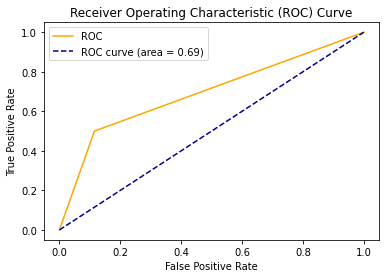

In [101]:
plt.plot(fpr, tpr, color='orange', label='ROC')
plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--',label='ROC curve (area = %0.2f)' % auc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

In [102]:
# FPR = 1 - specificity

In [ ]:
#logist regression task 

https://archive.ics.uci.edu/ml/datasets/Activity+Recognition+system+based+on+Multisensor+data+fusion+%28AReM%29#
    
Task Logistic Regression
~~~~~~~~~~~~~~~~~~~~~~~~~~~
1. WAP to read folder name and make a label in the csv with folder name
2. Remove unneccesarry info in Automated way
3. No other algorithm must be used other than Logistic Regression
4. Try to utilize multiple solvers and make multiple models
5. Provide the best models
6. EDA and all must be done accordingly
Note: No manual approaches will be appreciated